In [1]:
import pandas as pd
import numpy as np
import os
import folium
import geopandas as gpd

%matplotlib inline
import matplotlib.style
matplotlib.style.use("seaborn")
import matplotlib.pyplot as plt
import matplotlib.cm as cm
plt.rcParams["font.family"] = "Times New Roman"
import sys
sys.path.append(os.path.join("..", "..", "..", ".."))

In [2]:
safecom = pd.read_csv(os.path.join(os.path.abspath(os.path.join(os.getcwd(), os.pardir, os.pardir, os.pardir, os.pardir)),'data','SAFECOM','SAFECOM_data.csv'), index_col=0)

C:\Users\srandrad\AppData\Local\Temp\2\ipykernel_17740\536083068.py:1: DtypeWarning: Columns (28) have mixed types. Specify dtype option on import or set low_memory=False.
  safecom = pd.read_csv(os.path.join(os.path.abspath(os.path.join(os.getcwd(), os.pardir, os.pardir, os.pardir)),'data','SAFECOM','SAFECOM_data.csv'), index_col=0)


In [3]:
safecom.columns

Index(['Agency', 'Unit', 'Region', 'Location', 'Date', 'Local Time',
       'Date Submitted', 'Tracking #', 'Mission Type', 'Procurement Type',
       'Persons Onboard', 'Departure Point', 'Destination', 'Special Use',
       'Damages', 'Injuries', 'Hazardous Materials', 'Other Procurement Type',
       'Other Mission Type', 'Type', 'Manufacturer', 'Model', 'Narrative',
       'Corrective Action', 'Hazard', 'Incident', 'Management', 'UAS',
       'Accident', 'Airspace', 'Maintenance', 'Mishap Prevention'],
      dtype='object')

In [4]:
safecom['UAS'].unique()

array([nan, 'UAS', 'Fleet Operation', 'Loss of GPS', 'Incursion',
       'Fleet Operation, Loss of GPS', 'Contract Operation',
       'Fleet Operation, Loss of Link', 'Loss of Link',
       'Fleet Operation, Loss of Link, Loss of GPS',
       'Fleet Operation, Incursion', 'UAS, Fleet Operation',
       'UAS, Incursion', 'UAS, Fleet Operation, Loss of Link',
       'UAS, Loss of Link'], dtype=object)

In [5]:
safecom['Region'].unique()

array([nan, 'Alaska State Office', 'Idaho State Office',
       'California State Office', 'Nevada State Office',
       'Region 03 Southwest Region', 'Arizona State Office',
       'Utah State Office', 'Oregon/Washington State Office',
       'Wyoming State Office', 'DOI-OAS - Alaska Regional Office',
       'Colorado State Office', 'California',
       'Region 04 Intermountain Region',
       'Region 02 Rocky Mountain Region', 'New Mexico State Office',
       'Pacific Region', 'Montana/Dakotas State Office',
       'Region 01 Northern Rockies Region',
       'Region 08 Southern Area Region', 'Region 09 Eastern Area Region',
       'Region 10 Alaska Region', 'Utah', 'Florida',
       'Region 06 Pacific Northwest Region',
       'Region 05 Pacific Southwest Region', 'Texas', 'Washington Office',
       'Montana', 'Oregon', 'Arkansas', 'Washington', 'Minnesota',
       'Alaska', 'Oklahoma', 'North Carolina', 'Georgia',
       'DOI-OAS - Eastern Region Office', 'Eastern States Office',


In [6]:
UAS_safecom = safecom.loc[~(safecom['UAS'].isna())|(safecom['Type']=='Unmanned Aircraft System (UAS)')].reset_index(drop=True)

In [7]:
UAS_safecom['Mission Type'].unique()
non_fire_mission_types = ['Other', 'Wildlife, Animal Counting', 'Training, Other',
                          'Research', np.nan, 'Reconnaissance (Non-Fire)', 'Aerial Photography',
                          'Training, Pilot','Survey/Forest Health Protection (Non-Fire)','Training, Aircrew',
                          'Proficiency, Pilot', 'Wildlife, Animal Survey','Inspection (Aircraft)',
                          'Survey/Observation (Non-Fire)','Passenger Transport (Non-Fire)','Search/Rescue',
                          'Law Enforcement','Air Quality Monitoring','Offshore', 'Maintenance Test Flight'
                         ]
UAS_safecom_fire = UAS_safecom.loc[~UAS_safecom['Mission Type'].isin(non_fire_mission_types)].reset_index(drop=True)

In [8]:
UAS_safecom_fire['Mission Type'].unique()

array(['Fire, Water Drop (Helicopter Bucket)', 'Fire, Initial Attack',
       'Fire, Air Attack', 'Fire, Helitack', 'Fire, Reconnaissance',
       'Fire, Leadplane', 'Fire, Retardant Drop (SEAT)',
       'Fire, Aerial Ignition (Prescribed)',
       'Fire, Air-Attack (Prescribed)', 'Fire, Other',
       'Fire, Retardant Drop (Airtanker)', 'Fire, Aerial Ignition',
       'Fire, Retardant', 'Fire, Water Drop (Helicopter Fixed-Tank)',
       'Fire, External Load (Longline)', 'Fire, Infrared Imagery',
       'Fire, Passenger Transport', 'Fire, Water Drop (Fixed Wing)'],
      dtype=object)

In [9]:
UAS_safecom_fire

,Agency,Unit,Region,Location,Date,Local Time,Date Submitted,Tracking #,Mission Type,Procurement Type,...,Narrative,Corrective Action,Hazard,Incident,Management,UAS,Accident,Airspace,Maintenance,Mishap Prevention
0,State,NaN,Wyoming,"KYBG, Buffalo, West Ridge Fire",11/09/2014,2:00 PM,NaN,15-0052,"Fire, Water Drop (Helicopter Bucket)",Other/Unknown,...,On 11-08-2014 during the initial attack phase ...,The IC immediately confronted the individual w...,"Pilot Action, Other, Unqualified Personnel",NaN,NaN,NaN,NaN,"Intrusion, Procedures, Conflict, Congestion",NaN,Kudos
1,Bureau of Indian Affairs (BIA),NaN,NaN,213 Fire,04/12/2015,4:00 PM,NaN,15-0166,"Fire, Initial Attack",NaN,...,During initial attack of the 213 Fire south of...,The fire department has been notified that on ...,"Other, Unqualified Personnel",NaN,"Internal, External",NaN,NaN,Other,NaN,NaN
2,Forest Service (USFS),San Bernardino NF,Region 05 Pacific Southwest Region,Lake Fire BDF,06/24/2015,5:45 PM,NaN,15-0327,"Fire, Air Attack",Exclusive use contract,...,"At 1745 hours PST, while performing an air att...",All Fixed Wing Operations halted on south aspe...,NaN,Other,NaN,NaN,NaN,"Intrusion, Conflict",NaN,NaN
3,Forest Service (USFS),San Bernardino NF,Region 05 Pacific Southwest Region,Lake Fire Redlands Ca.,06/24/2015,11:00 PM,NaN,15-0339,"Fire, Water Drop (Helicopter Bucket)",CWN (Call when needed),...,While on USFS CWN Fire contract duties support...,PIC departed the area.Flight Crew was not awar...,Communications,Precautionary Landing,NaN,NaN,NaN,NaN,NaN,Kudos
4,Bureau of Land Management (BLM),Spokane District,Oregon/Washington State Office,Douglas Complex,07/11/2015,9:20 PM,NaN,15-0425,"Fire, Air Attack",Exclusive use contract,...,"On July 11, 2015 at approximately 2120 hours, ...",Information regarding the UAV intrusion was sh...,Other,NaN,External,NaN,NaN,Other,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,Forest Service (USFS),Plumas NF,Region 05 Pacific Southwest Region,Dixie Fire,09/12/2021,11::00 AM,NaN,21-0992,"Fire, Infrared Imagery",Fleet,...,Sept 12th 2021 10:43 - 11:03\r\nUAS was ordere...,"During this incident, coordination through the...",NaN,NaN,NaN,Loss of GPS,NaN,NaN,NaN,NaN
176,Forest Service (USFS),Gallatin NF,Region 01 Northern Rockies Region,"Shedhorn Mtn - South Big Sky, MT",09/27/2021,6:17 PM,NaN,21-1026,"Fire, Air Attack",Exclusive use contract,...,Air Attack was orbiting area to north of fire ...,RASM Comments: This is a duplicate for more i...,NaN,NaN,NaN,Incursion,NaN,NaN,NaN,NaN
177,Forest Service (USFS),Gallatin NF,Region 01 Northern Rockies Region,Shedhorn Fire South of Big Sky,09/28/2021,12:00 AM,NaN,21-1028,"Fire, Air Attack",Exclusive use contract,...,"AA-BBB was orbiting 12,500' offset 3 miles NE ...",Notified dispatch and immediately grounded all...,NaN,NaN,NaN,Incursion,NaN,NaN,NaN,NaN
178,Forest Service (USFS),Plumas NF,Region 05 Pacific Southwest Region,Black Mountain Lookout / Dixie East Div PP,10/03/2021,13:00 AM,NaN,22-0004,"Fire, Other",NaN,...,Sighting of a UAS in the area of the Black Mou...,Helibase and Susanville Dispatch notified of i...,NaN,NaN,NaN,Incursion,NaN,NaN,NaN,NaN


In [10]:
UAS_safecom_fire['Year'] = [UAS_safecom_fire.at[i,'Date'].split('/')[-1] for i in range(len(UAS_safecom_fire))]
UAS_safecom_fire['Day'] = [UAS_safecom_fire.at[i,'Date'].split('/')[1] for i in range(len(UAS_safecom_fire))]
UAS_safecom_fire['Month'] = [UAS_safecom_fire.at[i,'Date'].split('/')[0] for i in range(len(UAS_safecom_fire))]

In [11]:
UAS_safecom['Year'] = [UAS_safecom.at[i,'Date'].split('/')[-1] for i in range(len(UAS_safecom))]
UAS_safecom['Day'] = [UAS_safecom.at[i,'Date'].split('/')[1] for i in range(len(UAS_safecom))]
UAS_safecom['Month'] = [UAS_safecom.at[i,'Date'].split('/')[0] for i in range(len(UAS_safecom))]
UAS_safecom_comp = UAS_safecom.loc[(UAS_safecom['Year'].astype(int)>=2014) & (UAS_safecom['Year'].astype(int)<2022)].reset_index(drop=True)

In [12]:
UAS_safecom_comp['Year'].value_counts()

2018    77
2017    75
2021    74
2019    72
2016    71
2020    53
2015    22
2014     5
Name: Year, dtype: int64

In [13]:
years = ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021']
total_uas = [UAS_safecom_comp['Year'].value_counts()[year] for year in years]
uas_fire = [UAS_safecom_fire['Year'].value_counts()[year] for year in years]

In [14]:
years_data = pd.DataFrame({"Total UAS":total_uas, "Fire UAS":uas_fire}, index=years)

In [15]:
years_data

,Total UAS,Fire UAS
2014,5,1
2015,22,12
2016,71,24
2017,75,25
2018,77,19
2019,72,24
2020,53,35
2021,74,40


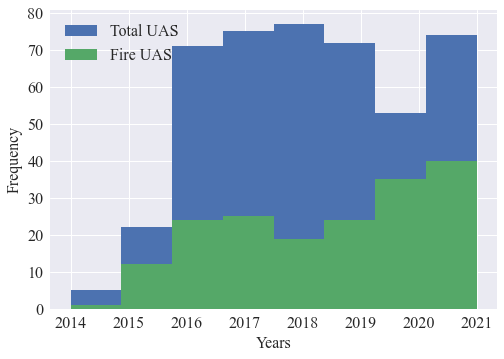

In [16]:
years = ['2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021','2022']
plt.hist(UAS_safecom_comp['Year'], bins=8,
         label='Total UAS')
plt.hist(UAS_safecom_fire['Year'], bins=8,
         label='Fire UAS')
plt.xlabel('Years', fontsize=16)
plt.tick_params(labelsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(fontsize=16)
plt.savefig('UAS_reports_histogram.pdf', bbox_inches="tight") 

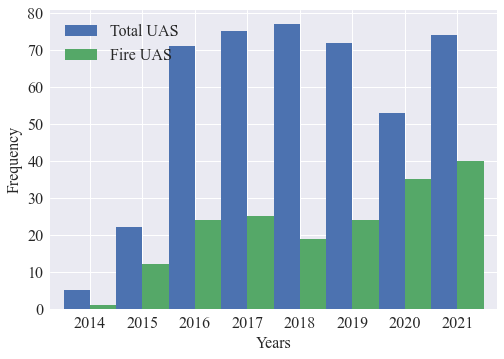

In [17]:
ax = years_data.plot.bar(rot=0, width=1)
plt.xlabel('Years', fontsize=16)
plt.tick_params(labelsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(fontsize=16,loc='upper left')
plt.savefig('UAS_reports_bar.pdf', bbox_inches="tight") 

In [18]:
#clean categories, strip of UAS if others included 
clean_cats = []
for cat in UAS_safecom_fire['UAS'].tolist():
    if type(cat) is str:
        if "UAS, " in cat:
            new_cat = cat.split(", ")
            new_cat.remove("UAS")
            if len(new_cat)>1:
                new_cat = ", ".join(new_cat)
            else:
                new_cat = new_cat[0]
            cat = new_cat
    clean_cats.append(cat)

            
    
UAS_safecom_fire['UAS_cleaned'] = clean_cats#[cat.split(", ").remove("UAS") for cat in UAS_safecom_fire['UAS'] if type(cat) is str and "UAS, " in cat]

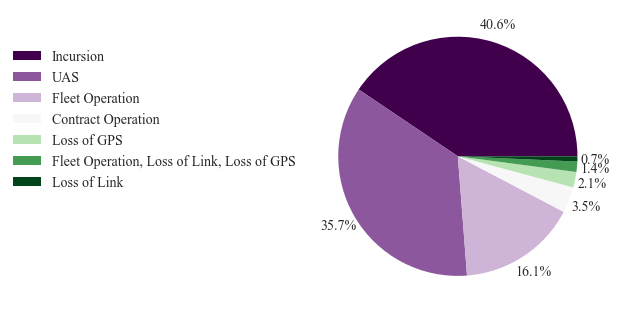

In [19]:
#graph categories
colors = cm.PRGn(np.linspace(0, 1, len(UAS_safecom_fire['UAS_cleaned'].value_counts())))
labels = UAS_safecom_fire['UAS_cleaned'].value_counts().index
plt.pie(UAS_safecom_fire['UAS_cleaned'].value_counts(), colors=colors, labels=labels,autopct='%1.1f%%',textprops={'fontsize': 14},labeldistance=None, pctdistance=1.15)
plt.legend(bbox_to_anchor=(0, 0.9),fontsize=14)
plt.savefig('UAS_categories.pdf', bbox_inches="tight") 
plt.show()

In [20]:
#UAS_safecom_fire.to_csv(os.path.join(os.path.dirname(os.getcwd()),'data', 'SAFECOM_UAS_fire_data.csv'))

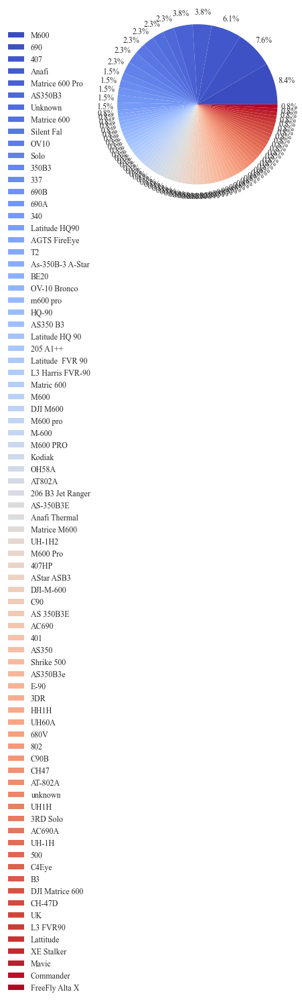

In [21]:
#graph aircraft model -> too many
colors = cm.coolwarm(np.linspace(0, 1, len(UAS_safecom_fire['Model'].value_counts())))
labels = UAS_safecom_fire['Model'].value_counts().index
plt.pie(UAS_safecom_fire['Model'].value_counts(), colors=colors, labels=labels,autopct='%1.1f%%',textprops={'fontsize': 12},labeldistance=None, pctdistance=1.15)
plt.legend(bbox_to_anchor=(0, 0.9),fontsize=12)
plt.show()

In [22]:
UAS_safecom_fire['Manufacturer'].value_counts().index

Index(['DJI', 'Aero Commander', 'Bell', 'Other', 'Unknown', 'Cessna',
       'Aerospatiale', 'Eurocopter', '3D Robotics', 'Parrot', 'Beechcraft',
       'Airbus', 'Air Tractor', 'North American', 'Boeing', 'Sikorsky',
       'Rockwell', 'Lockheed', 'Quest'],
      dtype='object')

In [23]:
UAS_safecom_fire['Type'].value_counts().index

Index(['Unmanned Aircraft System (UAS)', 'Helicopter', 'Airplane',
       'Airtanker (SEAT)', 'Helitanker', 'Airtanker (Multi-Engine)'],
      dtype='object')

In [24]:
UAS_safecom_fire['Model'].value_counts().index

Index(['M600', '690', '407', 'Anafi', 'Matrice 600 Pro', 'AS350B3', 'Unknown',
       'Matrice 600', 'Silent Fal', 'OV10', 'Solo', '350B3', '337', '690B',
       '690A', '340', 'Latitude HQ90', 'AGTS FireEye', 'T2',
       'As-350B-3 A-Star', 'BE20', 'OV-10 Bronco', 'm600 pro', 'HQ-90',
       'AS350 B3', 'Latitude HQ 90', '205 A1++', 'Latitude  FVR 90',
       'L3 Harris FVR-90', 'Matric 600', 'M600 ', 'DJI M600', 'M600 pro',
       'M-600', 'M600 PRO', 'Kodiak', 'OH58A', 'AT802A', '206 B3 Jet Ranger',
       'AS-350B3E', 'Anafi Thermal', 'Matrice M600', 'UH-1H2', 'M600 Pro',
       '407HP', 'AStar ASB3', 'DJI-M-600', 'C90', 'AS 350B3E', 'AC690', '401',
       'AS350', 'Shrike 500', 'AS350B3e', 'E-90', '3DR', 'HH1H', 'UH60A',
       '680V', '802', 'C90B', 'CH47', 'AT-802A', 'unknown', 'UH1H', '3RD Solo',
       'AC690A', 'UH-1H', '500', 'C4Eye', 'B3', 'DJI Matrice 600', 'CH-47D',
       'UK', 'L3 FVR90', 'Lattitude', 'XE Stalker', 'Mavic', 'Commander',
       'FreeFly Alta X'],
      

In [25]:
models = ['M600', 'Matrice 600', 'Matrice 600 Pro','m600 pro', 'Matric 600', 'Matrice M600', 'M600 pro',
          'M-600', 'M600 PRO','Matrice M600', 'M600 Pro','DJI Matrice 600',
          'Anafi','Anafi Thermal','Solo', '3RD Solo','Silent Fal']
missions = []
for mod in models:
    mod_df = UAS_safecom_fire.loc[UAS_safecom_fire['Model']==mod]
    missions.append(mod_df['Mission Type'].value_counts().index.values)
model_missions_df = pd.DataFrame({"Model":models, "Mission":missions})
model_missions_df

,Model,Mission
0,M600,"[Fire, Infrared Imagery, Fire, Aerial Ignition..."
1,Matrice 600,"[Fire, Infrared Imagery, Fire, Aerial Ignition]"
2,Matrice 600 Pro,"[Fire, Aerial Ignition, Fire, Infrared Imagery]"
3,m600 pro,"[Fire, Infrared Imagery]"
4,Matric 600,"[Fire, Infrared Imagery]"
5,Matrice M600,"[Fire, Aerial Ignition]"
6,M600 pro,"[Fire, Reconnaissance]"
7,M-600,"[Fire, Infrared Imagery]"
8,M600 PRO,"[Fire, Infrared Imagery]"
9,Matrice M600,"[Fire, Aerial Ignition]"


In [26]:
UAS_safecom_fire['Mission Type'].value_counts().index

Index(['Fire, Air Attack', 'Fire, Reconnaissance', 'Fire, Infrared Imagery',
       'Fire, Other', 'Fire, Initial Attack',
       'Fire, Water Drop (Helicopter Bucket)', 'Fire, Aerial Ignition',
       'Fire, Aerial Ignition (Prescribed)', 'Fire, Helitack',
       'Fire, Leadplane', 'Fire, Water Drop (Helicopter Fixed-Tank)',
       'Fire, Retardant Drop (SEAT)', 'Fire, External Load (Longline)',
       'Fire, Air-Attack (Prescribed)', 'Fire, Retardant Drop (Airtanker)',
       'Fire, Retardant', 'Fire, Passenger Transport',
       'Fire, Water Drop (Fixed Wing)'],
      dtype='object')

In [27]:
model_missions_df.iloc[0]['Mission']

array(['Fire, Infrared Imagery', 'Fire, Aerial Ignition',
       'Fire, Reconnaissance'], dtype=object)

In [28]:
#plot locations
UAS_safecom_fire['Region'].value_counts().index

Index(['Region 05 Pacific Southwest Region', 'Region 03 Southwest Region',
       'Region 06 Pacific Northwest Region', 'Region 04 Intermountain Region',
       'California', 'Region 01 Northern Rockies Region',
       'Region 02 Rocky Mountain Region', 'Region 08 Southern Area Region',
       'Utah', 'Washington', 'Nevada State Office', 'Minnesota',
       'California State Office', 'Wyoming State Office',
       'Oregon/Washington State Office', 'Alaska',
       'R4-Southeast Regional Office', 'Colorado State Office',
       'Arizona State Office', 'Idaho State Office', 'Texas', 'Pennsylvania',
       'Southeast Region', 'Intermountain Regional NPS Headquarters',
       'Pacific West Regional Office', 'Wyoming', 'Alaska State Office',
       'Region 10 Alaska Region', 'R7-Alaska Regional Office', 'Nevada',
       'Montana/Dakotas State Office'],
      dtype='object')

In [29]:
def correct_regions(df):
    region_dict ={
        'Region 05 Pacific Southwest Region': ['5', 'California', 'Hawaii', 'Pacific West Regional Office','California State Office','R2-Southwest Regional Office'],
        'Region 06 Pacific Northwest Region':['Oregon/Washington State Office', 'Washington', 'Oregon', 'Washington Office','R9-Washington Office',
                                             'PNW Research Station FIA','R1-Pacific Regional Office'],
        'Region 01 Northern Rockies Region':['Montana/Dakotas State Office', 'Montana'], 
        'Region 04 Intermountain Region':['Nevada State Office','DOI-OAS - Headquarters Boise', 'Intermountain Regional NPS Headquarters',
                                         'Utah','Utah State Office', 'Nevada', 'National Interagency Fire Center', 'DOI-OAS - Western Region Office',
                                         'DOI-OAS - Technical Services', 'DOI-OAS - Unmanned Aircraft System Office'],
        'Region 03 Southwest Region':['Southeast Region','Arizona State Office','Arizona','New Mexico','New Mexico State Office'],
        'Region 09 Eastern Area Region':['New Jersey', 'Pennsylvania', 'Minnesota','Pennsylvania','Midwest Regional NPS Headquarters','R3-Great Lakes - Big Rivers Regional Office',
                                        'Northeast Regional Office', 'DOI-OAS - Eastern Region Office','Northeastern Area, S&PF','Wisconsin','Eastern States Office','National Capitol Parks'],
        'Region 02 Rocky Mountain Region':['Colorado State Office', 'Colorado','R6-Mountain-Praire Regional Office', 'DMBM - Migratory Birds', 'Wyoming'], 
        'Region 08 Southern Area Region':['Gulf of Mexico Region','Texas','Oklahoma','North Carolina', 'South Carolina','Florida','R4-Southeast Regional Office'],
        'Region 10 Alaska Region': ['Alaska State Office','Alaska OCS Region', 'Alaska Regional Office', 'Alaska','DOI-OAS - Alaska Regional Office',
                                   'R7-Alaska Regional Office']

    }
    regions_corrected = []
    indices_to_drop = []
    for i in range(len(df)):
        current_region = df.iloc[i]['Region']
        correct_region = None
        for region in region_dict:
            if (region == current_region) or (current_region in region_dict[region]):
                correct_region = region
                break 
        if not correct_region:
            correct_region = current_region
        if correct_region in ['CAMP â€“ Campaign Against Marijuana Program', 'Commercial Aircraft Services', 'Aircraft Operations Center','National Capitol Parks', 'Department of Defense', 'National Guard']:
            indices_to_drop.append(i)
        if correct_region == 'Idaho':
            if df.iloc[i]['Location'] in ['Clear Creak Fire', 'garden valley', 'Idaho City', 'Idaho City Helibase (U98)','Ranft Fire']:
                correct_region = 'Region 04 Intermountain Region'
            else:
                correct_region = 'Region 01 Northern Rockies Region'
        elif correct_region == 'Pacific Region':
            correct_region = 'Region 05 Pacific Southwest Region'
        elif correct_region == 'Idaho State Office':
            if df.iloc[i]['Location'] in ['Granite Creek Fire', '47.512775, -116.002886','Post Falls, ID']:
                correct_region = 'Region 01 Northern Rockies Region'
            else: 
                correct_region = 'Region 04 Intermountain Region'
        elif correct_region == 'Wyoming State Office':
            if df.iloc[i]['Location'] in ['Tokewanna Fire','Rock Springs Sweetwater County', 'Evanston, WY Airport']:
                correct_region = 'Region 04 Intermountain Region'
            else:
                correct_region = 'Region 02 Rocky Mountain Region'
        regions_corrected.append(correct_region)

    df['region_corrected'] = regions_corrected
    df = df.drop(indices_to_drop, axis=0).reset_index(drop=True)
    return df

In [30]:
UAS_safecom_fire = correct_regions(UAS_safecom_fire)
val_counts = UAS_safecom_fire['region_corrected'].value_counts().sort_index()
val_counts

Region 01 Northern Rockies Region     12
Region 02 Rocky Mountain Region       16
Region 03 Southwest Region            21
Region 04 Intermountain Region        24
Region 05 Pacific Southwest Region    54
Region 06 Pacific Northwest Region    19
Region 08 Southern Area Region        13
Region 09 Eastern Area Region          5
Region 10 Alaska Region                5
Name: region_corrected, dtype: int64

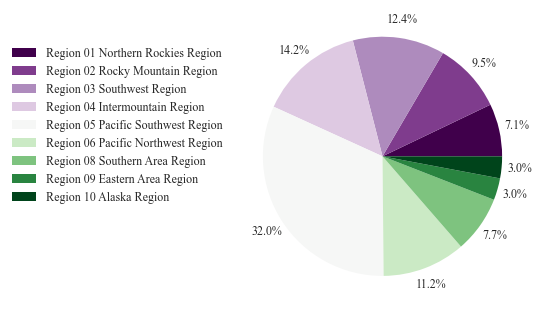

In [31]:
colors = cm.PRGn(np.linspace(0, 1, len(UAS_safecom_fire['region_corrected'].value_counts().sort_index())))
labels = UAS_safecom_fire['region_corrected'].value_counts().sort_index().index
plt.pie(UAS_safecom_fire['region_corrected'].value_counts().sort_index(), colors=colors, labels=labels,autopct='%1.1f%%',textprops={'fontsize': 12},labeldistance=None, pctdistance=1.15)
plt.legend(bbox_to_anchor=(0, 0.9),fontsize=12)
plt.savefig('UAS_regions.pdf', bbox_inches="tight") 
plt.show()

In [32]:
m = folium.Map(location=[48, -102], zoom_start=3)
os.path.join(os.path.abspath(os.path.join(os.getcwd(), os.pardir, os.pardir, os.pardir, os.pardir)),'data','SAFECOM','SAFECOM_data.csv')
file = os.path.join("USFS_Regions")
gdf = gpd.read_file(file, index_col=2)

In [33]:
region_data = pd.DataFrame()
region_data['Region'] = [" ".join([r for r in reg.split(" ")[2:-1]]) for reg in UAS_safecom_fire['region_corrected'].value_counts().index]
region_data['Count'] = UAS_safecom_fire['region_corrected'].value_counts().values

In [34]:
region_dict = {" ".join([r for r in reg.split(" ")[2:-1]]):UAS_safecom_fire['region_corrected'].value_counts()[reg] for reg in UAS_safecom_fire['region_corrected'].value_counts().index}

In [35]:
region_dict = {'Pacific Southwest': 54,
 'Intermountain': 24,
 'Southwestern': 21,
 'Pacific Northwest': 19,
 'Rocky Mountain': 16,
 'Southern': 13,
 'Northern': 12,
 'Eastern': 5,
 'Alaska': 5}

In [36]:
gdf['Count'] = [int(region_dict[reg]) for reg in gdf['REGIONNAME']]

In [37]:
gdf

,ADMINREGIO,REGION,REGIONNAME,REGIONHEAD,FS_ADMINAC,SHAPE_AREA,SHAPE_LEN,geometry,Count
0,99050000010343,05,Pacific Southwest,"Vallejo, CA",2.382722e+07,41.346143,54.728933,"MULTIPOLYGON (((-122.73130 42.08616, -122.7312...",54
1,99030000010343,03,Southwestern,"Albuquerque, NM",2.299736e+07,59.812087,36.278753,"POLYGON ((-103.00232 36.96834, -103.00232 36.9...",21
2,99090000010343,09,Eastern,"Milwaukee, WI",2.216008e+07,187.582342,273.308280,"MULTIPOLYGON (((-95.10313 49.36347, -95.09281 ...",5
3,99020000010343,02,Rocky Mountain,"Denver, CO",2.790607e+07,113.000323,54.655691,"POLYGON ((-96.56429 45.93349, -96.56496 45.930...",16
4,99080000010343,08,Southern,"Atlanta, GA",2.571606e+07,213.702492,245.696699,"MULTIPOLYGON (((-104.78203 31.99793, -104.7818...",13
5,99060000010343,06,Pacific Northwest,"Portland, OR",2.811717e+07,48.845383,54.830920,"POLYGON ((-122.25106 49.00249, -122.23256 49.0...",19
6,99010000010343,01,Northern,"Missoula, MT",2.816907e+07,76.673733,59.008713,"POLYGON ((-116.63807 45.78681, -116.64324 45.7...",12
7,99040000010343,04,Intermountain,"Ogden, UT",3.399656e+07,77.246116,47.951483,"POLYGON ((-113.98046 45.70232, -113.98045 45.7...",24
8,99100000010343,10,Alaska,"Juneau, AK",3.689160e+07,316.550116,250.196140,"MULTIPOLYGON (((-156.29748 71.41065, -156.2936...",5


In [38]:
m = folium.Map(location=[48, -102], zoom_start=3)

gjson = gdf.to_json()

df = pd.DataFrame(gdf)
folium.Choropleth(
    geo_data=gjson,
    name="choropleth",
    data=df,
    columns=["REGIONNAME", "Count"],
    key_on='feature.properties.REGIONNAME',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Number of Mishaps",
).add_to(m)

folium.LayerControl().add_to(m)

m

In [39]:
from selenium import webdriver
import time
m.save('map.html')
driver = webdriver.Chrome()
#driver.set_window_size(4000, 3000)  # choose a resolution
driver.get(os.path.join(os.getcwd(), 'map.html'))
time.sleep(5)
# You may need to add time.sleep(seconds) here
driver.save_screenshot('screenshot.png')
driver.quit()

SessionNotCreatedException: Message: session not created: This version of ChromeDriver only supports Chrome version 99
Current browser version is 104.0.5112.81 with binary path C:\Program Files (x86)\Google\Chrome\Application\chrome.exe
Stacktrace:
Backtrace:
	Ordinal0 [0x00919943+2595139]
	Ordinal0 [0x008AC9F1+2148849]
	Ordinal0 [0x007A4528+1066280]
	Ordinal0 [0x007C42C3+1196739]
	Ordinal0 [0x007BFE37+1179191]
	Ordinal0 [0x007BD6F1+1169137]
	Ordinal0 [0x007F0530+1377584]
	Ordinal0 [0x007F018A+1376650]
	Ordinal0 [0x007EB806+1357830]
	Ordinal0 [0x007C6086+1204358]
	Ordinal0 [0x007C6F96+1208214]
	GetHandleVerifier [0x00ABB232+1658114]
	GetHandleVerifier [0x00B7312C+2411516]
	GetHandleVerifier [0x009AF261+560433]
	GetHandleVerifier [0x009AE366+556598]
	Ordinal0 [0x008B286B+2173035]
	Ordinal0 [0x008B75F8+2192888]
	Ordinal0 [0x008B76E5+2193125]
	Ordinal0 [0x008C11FC+2232828]
	BaseThreadInitThunk [0x769CFA29+25]
	RtlGetAppContainerNamedObjectPath [0x77797A9E+286]
	RtlGetAppContainerNamedObjectPath [0x77797A6E+238]
